In [49]:
# !pip install plotly

In [74]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
import networkx as nx
import csv
import plotly.graph_objects as go
import numpy as np

from google.cloud import bigquery
import pandas as pd

In [75]:
df = pd.read_csv("theme_group.csv")
df.head(10)

,Source,SourceID,Persons,Locations,DocumentIdentifier,Mentions,Tags,GKG_DATE,topic,probability,probabilities
0,GDELT,20200301141500-219,khazanah nasional bhd;nikol pashinyan;katsunob...,"3#King County, Washington, United States#US#US...",https://www.msn.com/en-us/news/world/iran-case...,KILL#11##1#Iran#IR#IR#32#53#IR;KILL#35#new#1#S...,TAX_FNCACT;TAX_FNCACT_MAN;SCIENCE;TAX_FNCACT_R...,2020-03-01,1,0.516171,[0.51617131 0.00080573 0.03991768 0.10484112 0...
1,GDELT,20200301141500-18,hamad al-thani;fei liu;donald trump;robert red...,1#Qatar#QA#QA#25.5#51.25#QA;1#Australia#AS#AS#...,https://www.israelherald.com/news/264180355/ne...,KILL#70##1#Japan#JA#JA#36#138#JA;CRISISLEX_T03...,KILL;TAX_DISEASE;TAX_DISEASE_CORONAVIRUS;TAX_D...,2020-03-01,1,0.991365,[0.99136468 0.00107936 0.00107913 0.00107944 0...
2,GDELT,20200301141500-28,hamad al-thani;fei liu;donald trump;robert red...,1#Qatar#QA#QA#25.5#51.25#QA;1#Australia#AS#AS#...,https://www.malaysiasun.com/news/264180355/new...,KILL#70##1#Japan#JA#JA#36#138#JA;CRISISLEX_T03...,KILL;TAX_DISEASE;TAX_DISEASE_CORONAVIRUS;TAX_D...,2020-03-01,1,0.991365,[0.99136468 0.00107936 0.00107913 0.00107944 0...
3,GDELT,20200301141500-159,hamad al-thani;fei liu;donald trump;robert red...,1#Qatar#QA#QA#25.5#51.25#QA;1#Australia#AS#AS#...,https://www.pakistantelegraph.com/news/2641803...,KILL#70##1#Japan#JA#JA#36#138#JA;CRISISLEX_T03...,KILL;TAX_DISEASE;TAX_DISEASE_CORONAVIRUS;TAX_D...,2020-03-01,1,0.991365,[0.99136468 0.00107936 0.00107913 0.00107944 0...
4,GDELT,20200301141500-571,hamad al-thani;fei liu;donald trump;robert red...,1#Qatar#QA#QA#25.5#51.25#QA;1#Australia#AS#AS#...,https://www.londonmercury.com/news/264180355/n...,KILL#70##1#Japan#JA#JA#36#138#JA;CRISISLEX_T03...,KILL;TAX_DISEASE;TAX_DISEASE_CORONAVIRUS;TAX_D...,2020-03-01,1,0.991365,[0.99136468 0.00107936 0.00107913 0.00107944 0...
5,GDELT,20200301141500-589,hamad al-thani;fei liu;donald trump;robert red...,1#Qatar#QA#QA#25.5#51.25#QA;1#Australia#AS#AS#...,https://www.irishsun.com/news/264180355/new-co...,KILL#70##1#Japan#JA#JA#36#138#JA;CRISISLEX_T03...,KILL;TAX_DISEASE;TAX_DISEASE_CORONAVIRUS;TAX_D...,2020-03-01,1,0.991365,[0.99136468 0.00107936 0.00107913 0.00107944 0...
6,GDELT,20200301141500-638,hamad al-thani;fei liu;donald trump;robert red...,1#Qatar#QA#QA#25.5#51.25#QA;1#Australia#AS#AS#...,https://www.sanantoniopost.com/news/264180355/...,KILL#70##1#Japan#JA#JA#36#138#JA;CRISISLEX_T03...,KILL;TAX_DISEASE;TAX_DISEASE_CORONAVIRUS;TAX_D...,2020-03-01,1,0.991365,[0.99136468 0.00107936 0.00107913 0.00107944 0...
7,GDELT,20200301141500-985,hamad al-thani;fei liu;donald trump;robert red...,1#Qatar#QA#QA#25.5#51.25#QA;1#Australia#AS#AS#...,https://www.oklahomacitysun.com/news/264180355...,KILL#70##1#Japan#JA#JA#36#138#JA;CRISISLEX_T03...,KILL;TAX_DISEASE;TAX_DISEASE_CORONAVIRUS;TAX_D...,2020-03-01,1,0.991365,[0.99136468 0.00107936 0.00107913 0.00107944 0...
8,GDELT,20200301141500-1060,hamad al-thani;fei liu;donald trump;robert red...,1#Qatar#QA#QA#25.5#51.25#QA;1#Australia#AS#AS#...,https://www.calcuttanews.net/news/264180355/ne...,KILL#70##1#Japan#JA#JA#36#138#JA;CRISISLEX_T03...,KILL;TAX_DISEASE;TAX_DISEASE_CORONAVIRUS;TAX_D...,2020-03-01,1,0.991365,[0.99136468 0.00107936 0.00107913 0.00107944 0...
9,GDELT,20200301143000-863,naftali bennett;jung yeon-je;oxon hill;brett k...,"2#Louisiana, United States#US#USLA#31.1801#-91...",https://www.theaustralian.com.au/World?nk=b4a9...,"KILL#2##2#South Carolina, United States#US#USS...",TAX_FNCACT;TAX_FNCACT_VENDOR;TAX_WORLDMAMMALS;...,2020-03-01,6,0.254331,[0.17342814 0.2320908 0.04829246 0.00067804 0...


In [76]:
people = dict()


persons = df["Persons"].to_list()[:1000]
probability = df["probability"].to_list()[:1000]

for idx, person in enumerate(persons):
    persons_list = person.split(";")
    for p in persons_list:
        for neighbour in persons_list:
            if neighbour != p:
                if p not in people:
                    people[p] = dict()
                if neighbour not in people[p]:
                    people[p][neighbour] = 0
                if neighbour not in people:
                    people[neighbour] = dict()
                if p not in people[neighbour]:
                    people[neighbour][p] = 0
#                 print(p, )
                people[p][neighbour] += 1
                people[neighbour][p] += 1*probability[idx]
        
graph_data = dict()
graph_data['source'] = []
graph_data['target'] = []
graph_data['weight'] = []

for src, v in people.items():
    for dst, weight in v.items():
        graph_data['source'].append(src)
        graph_data['target'].append(dst)
        graph_data['weight'].append(weight)
        

        
graph_df = pd.DataFrame.from_dict(graph_data)
df_sample = graph_df.sample(frac=0.25)

# print(len(df_sample))
df_sample.head(100)

/opt/conda/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,source,target,weight
22583,mohammed tawfiq allawi,dulat aghadil,1.279349
7275,ma xiaowei,matt sedensky,1.443262
21862,domingos sim,sungai kolok,1.279349
9361,christian galani,todd m casey,1.575660
11881,peter altmaier,jerome powell,4.085959
...,...,...,...
14630,toumani djim,delphin kahimbi,1.279349
21016,bam dev gautam,brent christensen,1.279349
19745,tareck el aissami,jund al khilafa,1.279349
3268,ahmad tibi,anwar ibrahim,2.508662


In [77]:
G = nx.from_pandas_edgelist(graph_df, 
                            source='source',
                            target='target',
                            edge_attr='weight')

nx.info(G)

/opt/conda/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


'Name: \nType: Graph\nNumber of nodes: 1591\nNumber of edges: 20038\nAverage degree:  25.1892'

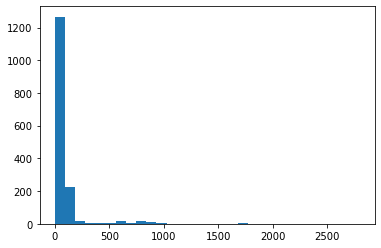

In [78]:
weighted_degrees = dict(nx.degree(G ,weight='weight'))
max_degree = max(weighted_degrees.values())

h = plt.hist(weighted_degrees.values(), bins = 30)

In [79]:
# isolating prominent links with sparse connections only
subG = G.subgraph([n for n in weighted_degrees if weighted_degrees[n]>100])

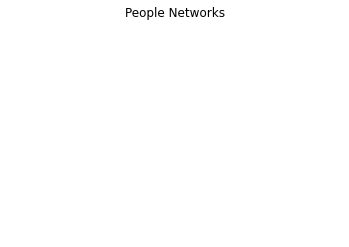

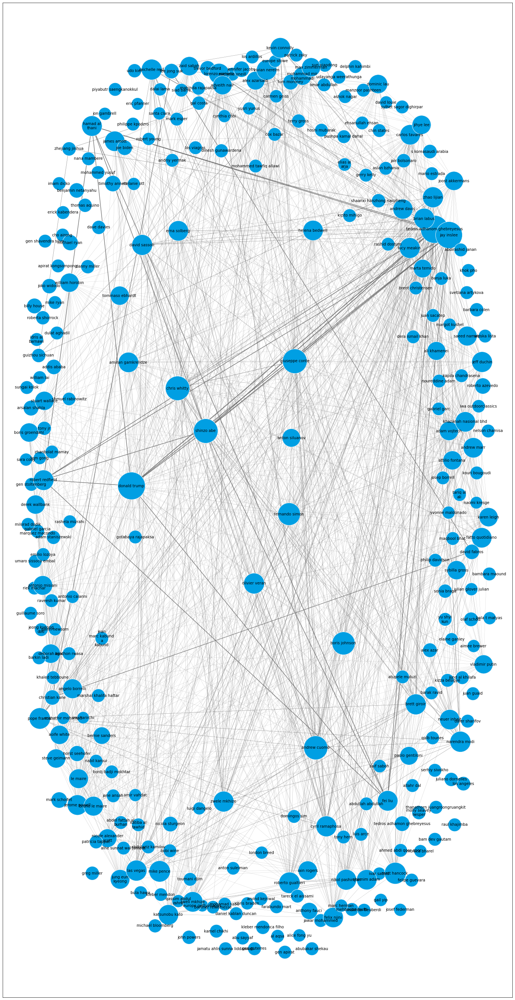

In [80]:
pos = nx.spring_layout(subG, weight='weight',iterations=20, k = 4)

plt.axis('off')
plt.title('People Networks',fontsize = 12)
plt.figure(figsize=(24,48))

for node in subG.nodes():
    size = 100*weighted_degrees[node]**0.5
    ns = nx.draw_networkx_nodes(subG,pos,nodelist=[node], node_size=size, node_color='#009fe3')
    ns.set_edgecolor('#f2f6fa')

nx.draw_networkx_labels(subG,pos,{n:n.replace('-','\n') for n in subG.nodes() if weighted_degrees[n]>100},font_size=10);

for e in subG.edges(data=True):
    if e[2]['weight']>10:
        nx.draw_networkx_edges(subG,pos,[e],width=e[2]['weight']/100,edge_color='#707070')

In [70]:
infection_times = {}

In [71]:
def independent_cascade(G,t,infection_times):
    #doing a t->t+1 step of independent_cascade simulation
    #each infectious node infects neigbors with probabilty proportional to the weight
    max_weight = max([e[2]['weight'] for e in G.edges(data=True)])
    current_infectious = [n for n in infection_times if infection_times[n]==t]
    for n in current_infectious:
        for v in G.neighbors(n):
            if v not in infection_times:
                if  G.get_edge_data(n,v)['weight'] >= np.random.random()*max_weight:
                    infection_times[v] = t+1
    return infection_times

In [72]:
def plot_G(G,pos,infection_times,t):
    current_infectious = [n for n in infection_times if infection_times[n]==t]
    plt.figure()
    plt.axis('off')
    plt.title('Game of Thrones Network, t={}'.format(t),fontsize = 24)
    plt.figure(figsize=(24,48))

    for node in G.nodes():
        size = 100*weighted_degrees[node]**0.5
        if node in current_infectious:
            ns = nx.draw_networkx_nodes(G,pos,nodelist=[node], node_size=size, node_color='#feba02')
        elif infection_times.get(node,9999999)<t:
            ns = nx.draw_networkx_nodes(G,pos,nodelist=[node], node_size=size, node_color='#f2f6fa')
        else:
            ns = nx.draw_networkx_nodes(G,pos,nodelist=[node], node_size=size, node_color='#009fe3')
        ns.set_edgecolor('#f2f6fa')
    nx.draw_networkx_labels(G,pos,{n:n.replace('-','\n') for n in G.nodes() if weighted_degrees[n]>100},font_size=10);

    for e in G.edges(data=True):
        if e[2]['weight']>10:
            nx.draw_networkx_edges(G,pos,[e],width=e[2]['weight']/100,edge_color='#707070')

In [83]:
# suppose "amiran gamkrelidze" and "greg miller" interact with "helena bedwell"
# *** [we're using 3 nodes for quick computation, but all nodes can be seeded to analyze the potential affinity of every person on the network]
# we'll monitor the spread of connections and info
# print(graph_data)

infection_times = {'amiran gamkrelidze':-1,'greg miller':-1,'helena bedwell':0}

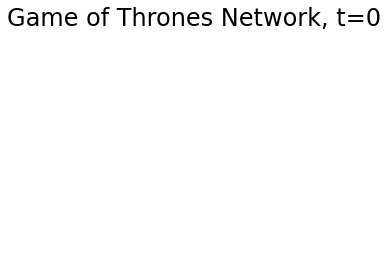

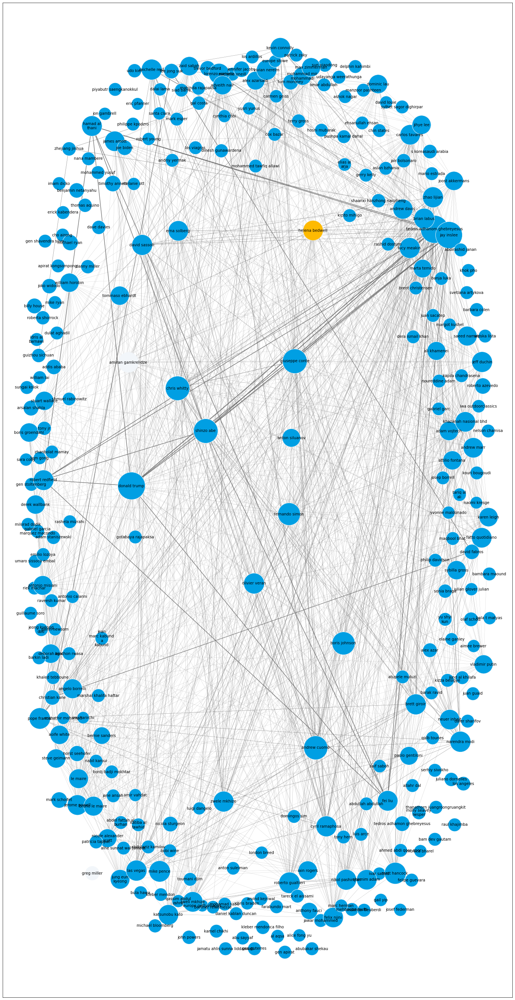

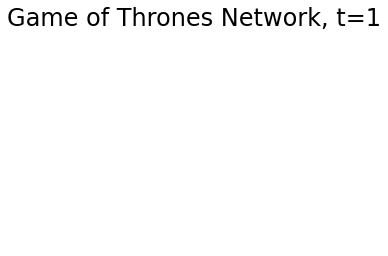

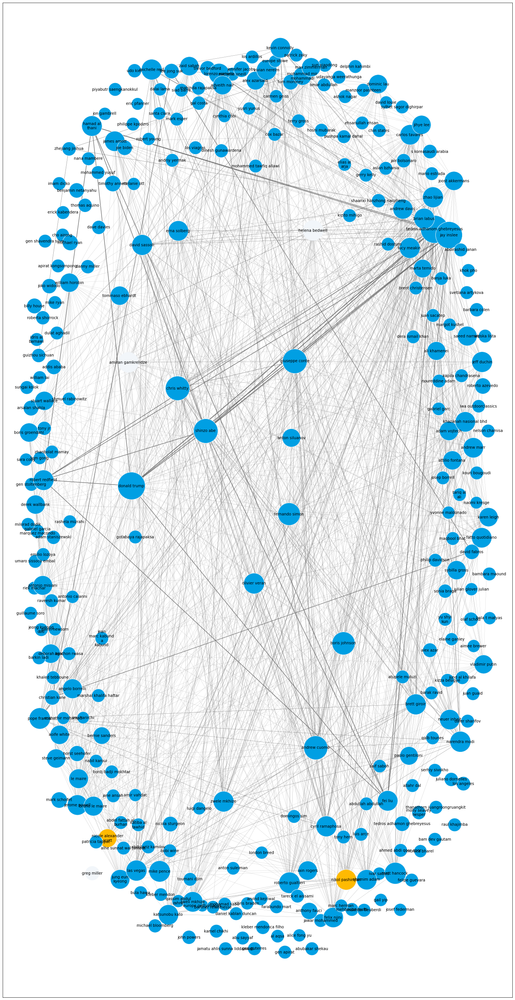

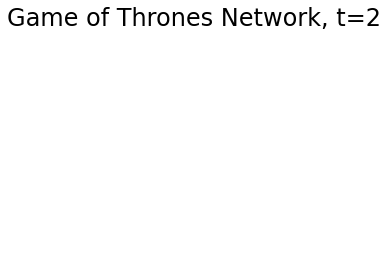

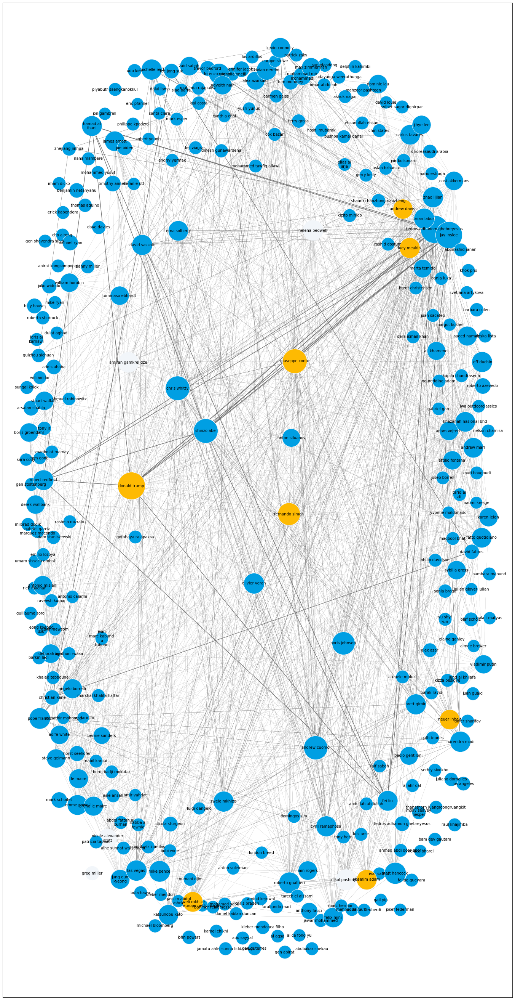

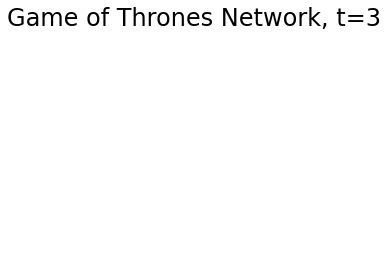

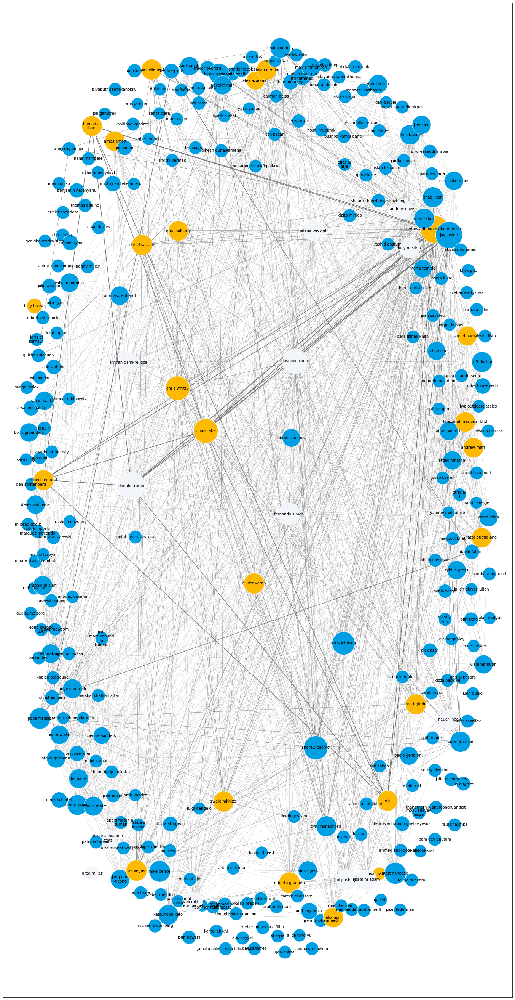

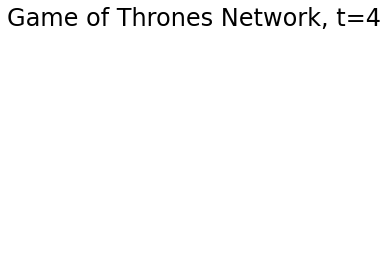

In [ ]:
for t in range(10):
    plot_G(subG,pos,infection_times,t)
    infection_times = independent_cascade(subG,t,infection_times)

In [ ]:
# # this prepares the centrality metrics for info seeding [takes more than 7 hours on current data set]

# max_budget = len(subG.nodes())
# trials = 50
# all_results = []
# for budget in tqdm.tqdm_notebook(range(max_budget)):
#     results = {'budget':budget}
#     for method in methods:
#         infections = []
#         for i in range(trials):
#             infected = 0
#             t= 0
#             infection_times = {n:0 for n in top.sort_values(method,ascending=False).index[:budget]}
#             while len(infection_times)>infected:
#                 #t+=1
#                 infected = len(infection_times)
#                 infection_times = independent_cascade(subG,t,infection_times)
#                 t+=1
#             infections.append(infected)
#         results[method] = np.round(np.mean(infections)/len(subG.nodes()),2)

#     all_results.append(results)
              

In [ ]:
# res_df = pd.concat([pd.DataFrame.from_dict(r,orient='index').T 
#                         for r in all_results]).set_index('budget')

In [ ]:
# res_df.index = res_df.index/len(subG.nodes())
# res_df.head()

In [ ]:
# # visualization of information infection

# res_df.plot()
# plt.legend(fontsize = 18)
# plt.ylabel('Virality rate (out of total graph size)',fontsize = 18)
# plt.xlabel('Seeding Budget (out of graph size)', fontsize = 18)

In [ ]:
# from itertools import product

# budget=2

# seed_sets = list(product(*[subG.nodes()]*budget))

# print(len(seed_sets),'Seeding options')

In [ ]:
## takes more than 7 hours

# budget = 2
# trials = 20
# all_results = []
# results = {'budget':budget}
# for seed in tqdm.tqdm_notebook(seed_sets[:]):
#     infections = []
#     for i in range(trials):
#         infected = 0
#         t= 0
#         infection_times = {n:0 for n in seed}
#         while len(infection_times)>infected:
#             #t+=1
#             infected = len(infection_times)
#             infection_times = independent_cascade(subG,t,infection_times)
#             t+=1
#         infections.append(infected)
#     results[seed] = np.round(np.mean(infections)/len(subG.nodes()),2)

# all_results.append(results)

In [ ]:
# sorted(results.items(), key = lambda x: x[1], reverse=True)[:10]